In [4]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import pickle

In [5]:
def save_dataset(X_train, Y_train, file_path):
    """Save the training dataset to a file."""
    with open(file_path, 'wb') as f:
        pickle.dump({'X': X_train, 'Y': Y_train}, f)
    print(f"Saved samples to {file_path}")

In [6]:
import xrd
from importlib import reload
reload(xrd)

X_train, Y_train = xrd.generate_train_dataset(100_000)

Invalid D01 value: 0.0034632779398426567 0.0016472871089678893 0
Invalid D01 value: 0.004836503608267216 0.0009487716754191054 4
Invalid D01 value: 0.00291645758337233 0.001081222116948321 5
Invalid D01 value: 0.012401500446327159 0.0019213901718916002 11
Invalid D01 value: 0.002059376747759539 0.0013602803895230607 15
Invalid D01 value: 0.007268710527140137 0.0007993330813749746 15
Invalid D01 value: 0.016689689997502075 0.0014678578258804295 17
Invalid D01 value: 0.004834663207587242 0.00024397526405100026 18
Invalid D01 value: 0.003153277652012613 0.0007186766310179633 20
Invalid D01 value: 0.009203859773665474 0.0008251926320303072 20
Invalid D01 value: 0.002532919928703816 0.00017220576734310045 24
Invalid D01 value: 0.007020294033224853 0.00015024688223903068 37
Invalid D01 value: 0.002081549058923342 8.787981749777988e-05 40
Invalid D01 value: 0.011857336276111258 0.0013009720351786474 42
Invalid D01 value: 0.014343407734463735 0.00010395696372189275 43
Invalid D01 value: 0.0081

/Users/vekeryk/Projects/master-project/workspace/modules/xrd.py:568: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/utils/tensor_new.cpp:278.)
  Y = torch.tensor(Y, dtype=torch.float32, device=device)


In [7]:
save_dataset(X_train, Y_train, "datasets/long_run.pkl")

Saved samples to datasets/long_run.pkl


<Figure size 1200x600 with 0 Axes>

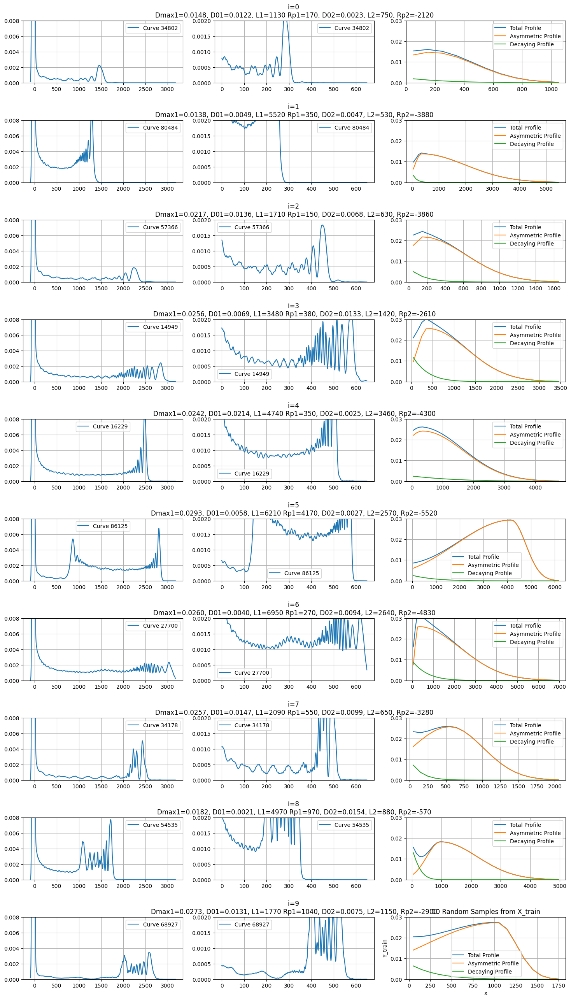

In [8]:
import xrd
from importlib import reload
reload(xrd)

rng = np.random.default_rng()
indices = rng.choice(X_train.shape[0], size=10, replace=False)
plt.figure(figsize=(12, 6))

fig, axes = plt.subplots(len(indices), 3, figsize=(18, 32))
plt.subplots_adjust(hspace=0.6)  # add vertical space between rows

# for idx in indices:
#     # plt.plot(x.cpu().numpy(), Y_train[idx].cpu().numpy(), label=f"Sample {idx}")
#     curve, profile = xrd.compute_curve_and_profile(X_train[idx])

for i, idx in enumerate(indices):
    # print(X_train[idx])
    curve, profile = xrd.compute_curve_and_profile(tensor=X_train[idx])
    axes[i, 0].plot(curve.X_DeltaTeta, curve.Y_R_vseZ, label=f"Curve {idx}")
    # axes[i, 0].set_title(f"Sample {idx}\nX_train: [{X_train[idx][0]:.4f}, {X_train[idx][1]:.4f}, {X_train[idx][2]:.4f}]")
    axes[i, 0].grid(True)
    axes[i, 0].set_ylim(0, 0.008)
    axes[i, 0].legend()

    axes[i, 1].plot(curve.X, curve.Y, label=f"Curve {idx}")
    axes[i, 1].set_title(
        f"i={i} \nDmax1={X_train[idx][0]:.4f}, D01={X_train[idx][1]:.4f}, L1={X_train[idx][2]*1e8:.0f} "
        f"Rp1={X_train[idx][3]*1e8:.0f}, D02={X_train[idx][4]:.4f}, L2={X_train[idx][5]*1e8:.0f}, Rp2={X_train[idx][6]*1e8:.0f}"
    )
    axes[i, 1].grid(True)
    axes[i, 1].set_ylim(0, 0.002)
    axes[i, 1].legend()

    axes[i, 2].plot(profile.X, profile.total_Y, label="Total Profile")
    axes[i, 2].plot(profile.X, profile.asymmetric_Y, label="Asymmetric Profile")
    axes[i, 2].plot(profile.X, profile.decaying_Y, label="Decaying Profile")
    # axes[i, 2].set_title(f"Profile {idx}")
    axes[i, 2].set_ylim(0, 0.03)
    axes[i, 2].grid(True)
    axes[i, 2].legend()

plt.title("10 Random Samples from X_train")
plt.xlabel("x")
plt.ylabel("Y_train")
plt.grid(True)
plt.legend()
plt.show()

In [9]:
import xrd
from importlib import reload
reload(xrd)

X_train, Y_train = xrd.generate_train_dataset(1_000_000)

Invalid D01 value: 0.0038096591534903723 0.00039568458853359804 1
Invalid D01 value: 0.0030441127450336275 0.0003485189488895159 3
Invalid D01 value: 0.007351877418553792 0.0008132796282836596 4
Invalid D01 value: 0.0025413154521868823 0.0005817024799202476 7
Invalid D01 value: 0.002189589825509494 0.0004641643260657655 11
Invalid D01 value: 0.002280298361633372 0.0010864502637780008 11
Invalid D01 value: 0.0020825731328801477 0.0010823381192803508 16
Invalid D01 value: 0.01106185168131221 0.00033685733375399263 16
Invalid D01 value: 0.02445010963598218 0.001900928843568045 21
Invalid D01 value: 0.01845510435946729 0.0013225919190855279 21
Invalid D01 value: 0.0033736995512822585 0.0009876756327191222 21
Invalid D01 value: 0.006240054044475051 0.0001710174002325449 22
Invalid D01 value: 0.015419351902002736 0.0010211001913722397 22
Invalid D01 value: 0.0022980535523826214 0.00030320767136736513 23
Invalid D01 value: 0.018100503823866784 0.00027883520315827304 23
Invalid D01 value: 0.00

In [10]:
save_dataset(X_train, Y_train, "datasets/long_run_mil.pkl")

Saved samples to datasets/long_run_mil.pkl
